In [27]:
pip install dataprep


Note: you may need to restart the kernel to use updated packages.


In [26]:
pip install lazypredict

  Attempting uninstall: numpy
    Found existing installation: numpy 1.20.1
    Uninstalling numpy-1.20.1:
      Successfully uninstalled numpy-1.20.1
Note: you may need to restart the kernel to use updated packages.


ERROR: Could not install packages due to an OSError: [WinError 5] Access is denied: 'D:\\Anaconda\\Lib\\site-packages\\~umpy\\core\\_multiarray_tests.cp38-win_amd64.pyd'
Consider using the `--user` option or check the permissions.



NumExpr defaulting to 8 threads.


  0%|                                                                                         | 0/1101 [00:00<…

DataPrep Report
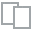
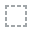
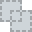
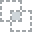
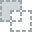
...
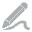
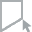
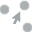
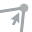
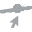

In [3]:
from dataprep.eda import create_report
import pandas as pd
df = pd.read_excel(r"C:\Users\sndpy\Downloads\Flight_Ticket_Participant_Datasets\Data_Train.xlsx")
create_report(df)

The heat Map method shows variables having missing values in terms of correlation. Since ‘Route’ and ‘Total_Stops’ both are highly correlated, they both have missing values.


As we can observe ‘Route’ and ‘Total_Stops’ variables have missing values. Since we did not find any missing values information from Bar-Chart and Spectrum method but we found missing value variables using the Heat Map method. Combining both of these information, we can say that the ‘Route’ and ‘Total_Stops’ variables have missing values but are very low.

Data Preparation

In [4]:
df.head()

,Airline,Date_of_Journey,Source,Destination,Route,Dep_Time,Arrival_Time,Duration,Total_Stops,Additional_Info,Price
0,IndiGo,24/03/2019,Banglore,New Delhi,BLR → DEL,22:20,01:10 22 Mar,2h 50m,non-stop,No info,3897
1,Air India,1/05/2019,Kolkata,Banglore,CCU → IXR → BBI → BLR,05:50,13:15,7h 25m,2 stops,No info,7662
2,Jet Airways,9/06/2019,Delhi,Cochin,DEL → LKO → BOM → COK,09:25,04:25 10 Jun,19h,2 stops,No info,13882
3,IndiGo,12/05/2019,Kolkata,Banglore,CCU → NAG → BLR,18:05,23:30,5h 25m,1 stop,No info,6218
4,IndiGo,01/03/2019,Banglore,New Delhi,BLR → NAG → DEL,16:50,21:35,4h 45m,1 stop,No info,13302


Few observations about some of the variables:

1. ‘Price‘ will be our dependent variable and all remaining variables can be used as independent variables.

2. ‘Total_Stops‘ can be used to determine if the flight was direct or connecting.

Handling Missing Values

As we found out the ‘Route’ and ‘Total_Stops’ variables have very low missing values in data. Let’s now see the percentage of missing values in data.

In [5]:
(df.isnull().sum()/df.shape[0])*100

Airline            0.000000
Date_of_Journey    0.000000
Source             0.000000
Destination        0.000000
Route              0.009361
Dep_Time           0.000000
Arrival_Time       0.000000
Duration           0.000000
Total_Stops        0.009361
Additional_Info    0.000000
Price              0.000000
dtype: float64

As we can observe ‘Route’ and ‘Total_Stops’ both have 0.0094% of missing values. In this case, it is better to drop missing values.

In [6]:
df.dropna(inplace= True)
df.isnull().sum()

Airline            0
Date_of_Journey    0
Source             0
Destination        0
Route              0
Dep_Time           0
Arrival_Time       0
Duration           0
Total_Stops        0
Additional_Info    0
Price              0
dtype: int64

Now we don’t have any missing values.

Handling Date and Time Variables

We have ‘Date_of_Journey’, a ‘date type variable and ‘Dep_Time’, ‘Arrival_Time’ that captures time information.

We can extract ‘Journey_day’ and ‘Journey_Month’ from the ‘Date_of_Journey’ variable. ‘Journey day’ shows the day of the month on which the journey was started.

In [7]:
df["Journey_day"] = pd.to_datetime(df.Date_of_Journey, format="%d/%m/%Y").dt.day
df["Journey_month"] = pd.to_datetime(df["Date_of_Journey"], format = "%d/%m/%Y").dt.month
df.drop(["Date_of_Journey"], axis = 1, inplace = True)

Similarly, we can extract ‘Departure_Hour’ and ‘Departure_Minute’ as well as ‘Arrival_Hour and ‘Arrival_Minute’ from ‘Dep_Time’ and ‘Arrival_Time’ variables respectively.

In [8]:
df["Dep_hour"] = pd.to_datetime(df["Dep_Time"]).dt.hour
df["Dep_min"] = pd.to_datetime(df["Dep_Time"]).dt.minute
df.drop(["Dep_Time"], axis = 1, inplace = True)

In [9]:
df["Arrival_hour"] = pd.to_datetime(df.Arrival_Time).dt.hour
df["Arrival_min"] = pd.to_datetime(df.Arrival_Time).dt.minute
df.drop(["Arrival_Time"], axis = 1, inplace = True)

We also have duration information on the ‘Duration’ variable. This variable contains both duration hours and minutes information combined.

We can extract ‘Duration_hours’ and ‘Duration_minutes’ separately from the ‘Duration’ variable.

In [10]:
def get_duration(x):
    x=x.split(' ')
    hours=0
    mins=0
    if len(x)==1:
        x=x[0]
        if x[-1]=='h':
            hours=int(x[:-1])
        else:
            mins=int(x[:-1])
    else:
        hours=int(x[0][:-1])
        mins=int(x[1][:-1])
    return hours,mins
df['Duration_hours']=df.Duration.apply(lambda x:get_duration(x)[0])
df['Duration_mins']=df.Duration.apply(lambda x:get_duration(x)[1])
df.drop(["Duration"], axis = 1, inplace = True)

Handling Categorical Data

Airline, Source, Destination, Route, Total_Stops, Additional_info are the categorical variables we have in our data. Let’s handle each one by one.

Airline Variable

Let’s see how the Airline variable is related to the Price variable.

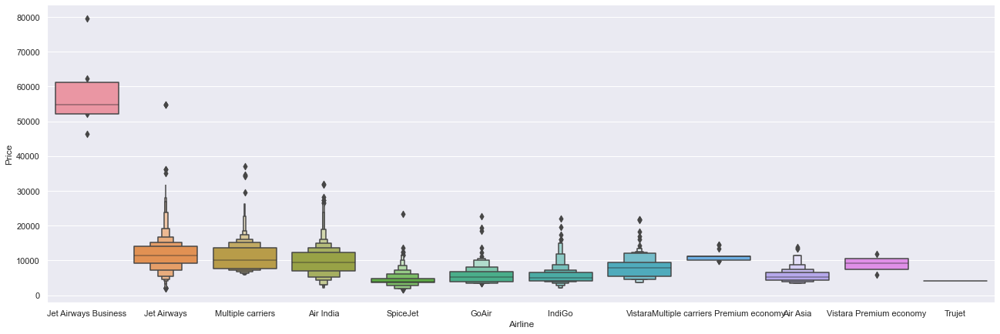

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.set()
sns.catplot(y = "Price", x = "Airline", data = df.sort_values("Price", ascending = False), kind="boxen", height = 6, aspect = 3)
plt.show()

As we can see the name of the airline matters. ‘JetAirways Business’ has the highest price range. Other airlines price also varies.

Since the Airline variable is Nominal Categorical Data (There is no order of any kind in airline names) we will use one-hot encoding to handle this variable.

In [12]:
Airline = df[["Airline"]]
Airline = pd.get_dummies(Airline, drop_first= True)

In [13]:
#One-Hot encoded ‘Airline’ data is saved in the Airline variable as shown in the above code.

Source  and Destination Variable

Again ‘Source’ and ‘Destination’ variables are Nominal Categorical Data. We will use One-Hot encoding again to handle these two variables.

In [14]:
Source = df[["Source"]]
Source = pd.get_dummies(Source, drop_first= True)
Destination = df[["Destination"]]
Destination = pd.get_dummies(Destination, drop_first = True)

Route variable

Route variable represents the path of the journey. Since the ‘Total_Stops’ variable captures the information if the flight is direct or connected so I have decided to drop this variable.

In [15]:
df.drop(["Route", "Additional_Info"], axis = 1, inplace = True)

Total_Stops Variable

In [16]:
df["Total_Stops"].unique()

array(['non-stop', '2 stops', '1 stop', '3 stops', '4 stops'],
      dtype=object)

Here, non-stop means 0 stops which means direct flight. Similarly meaning other values is obvious. We can see it is an Ordinal Categorical Data so we will use LabelEncoder here to handle this variable.

In [17]:
df.Additional_Info.unique()

AttributeError: 'DataFrame' object has no attribute 'Additional_Info'

Final Dataframe

Now we will create the final dataframe by concatenating all the One-hot and Label-encoded features to the original dataframe. We will also remove original variables using which we have prepared new encoded variables.

In [20]:
df = pd.concat([df, Airline, Source, Destination], axis = 1)
df.drop(["Airline", "Source", "Destination"], axis = 1, inplace = True)

In [21]:
df.shape[1]

50

Model Building

In [23]:
X=df.drop('Price',axis=1)
y=df['Price']
#train-test split
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)

Applying Lazy Prediction

In [33]:
#Since we are working on a Regression task we will use Regressor models.
import lazypredict
from sklearn import datasets
from sklearn.utils import shuffle
import numpy as np

from lazypredict.Supervised import LazyRegressor
reg = LazyRegressor(verbose=0, ignore_warnings=False, custom_metric=None)
models, predictions = reg.fit(x_train, x_test, y_train, y_test)
models.head(10)

ModuleNotFoundError: No module named 'lazypredict'

Model Training

In [39]:
import xgboost

from xgboost import XGBRegressor
model =  XGBRegressor()
model.fit(X_train,y_train)

ModuleNotFoundError: No module named 'xgboost'

In [37]:
#Let’s check Model performance

y_pred =  model.predict(x_test)
print('Training Score :',model.score(x_train, y_train))
print('Test Score     :',model.score(x_test, y_test))

NameError: name 'model' is not defined

NameError: name 'y_pred' is not defined

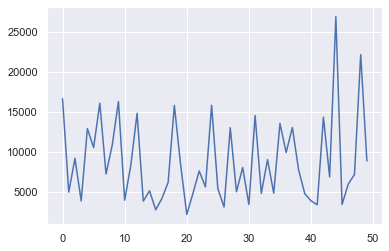

In [38]:
#Let’s visualize the results of few predictions.

number_of_observations=50

x_ax = range(len(y_test[:number_of_observations]))

plt.plot(x_ax, y_test[:number_of_observations], label="original")

plt.plot(x_ax, y_pred[:number_of_observations], label="predicted")

plt.title("Flight Price test and predicted data")

plt.xlabel('Observation Number')

plt.ylabel('Price')

plt.legend()

plt.show()




Conclusion

Lazy Prediction saves time and efforts to build a machine learning model by providing model performance and training time. One can choose either based on the situation at hand.